## HW1 Assignment

1.	Create **ten hypotheses** to test about relationships between potential predictors and diabetes patient engagement. 
An example might be that patients who live close to a clinic are more likely to be highly engaged in their treatment. You may use the readings, information gathered in class, searching the Web, or talking to subject matter experts to generate your hypotheses.  


2.	**Profile the data** in the files using Python as follows: 
Profiling should include at a minimum the number of records in a file, the fields in a record, and for each field, the format of the data, units, the range of values, and summary statistics for numeric data. You should create some **data visualizations to understand the range of values and spot outliers**. 
If you are not familiar with data preparation steps, a good reference is Chapter 3, “Data Preprocessing” in J. Han, M. Kamber and J. Pei, Data Mining Concepts and Techniques, Third Edition, Morgan Kaufmann, 2012 (see slides in https://hanj.cs.illinois.edu/bk3/bk3_slides/03Preprocessing.ppt) 


3.	Derive a subset of the care events (engagement outcomes) from the data files as follows:
*   Skips appointment 
*	Cancels appointment
*	Reschedules appointment

4.	Derive a subset of the engagement predictor variables in the following categories 
*	Demographics. For example, marital status could be derived from EstadoCivil 
*	Geography. For example, distance from clinic is dependent on city and state which are in Ciudad and Estado respectively

## Importing data and translating headers

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from dataprep.eda import create_report

#READ EXCEL DATA FILE AND SHEET NAMES TO BE ANALYZED
data_xl = pd.ExcelFile('./Balance - Tablas (Parte 1 ).xlsx')
SA_sheets = data_xl.sheet_names[4:8]
print(SA_sheets)

NumExpr defaulting to 8 threads.


['hc_hospitalizaciones', 'historialcitascanceladas', 'historialcitasagendadas', 'pacientes']


In [2]:
#READING SPECIFIC SHEETS TO DATAFRAME DICTIONARY
list_pandas = []
list_columns = []
for i in range(4):
    list_pandas.append(data_xl.parse(SA_sheets[i]))
    list_columns.append(list_pandas[i].columns)

#READING COLUMN HEADER DICTIONARY SPANISH TO ENGLISH
translate_dict = pd.read_excel('./DataDictionary.xlsx')
translate_dict.head(3)
dict_dictionary = dict(zip(translate_dict['Field'], translate_dict['Description']))

In [3]:
#ORIGINAL HEADERS
print(list_columns)

[Index(['Comentarios', 'Causas', 'Dias', 'Anio', 'IdPaciente',
       'IdHospitalizacion'],
      dtype='object'), Index(['IdHistorialCitaCancelada', 'IdAgenda', 'IdPaciente', 'Area', 'Fecha',
       'Hora', 'FechaAlta', 'Asistencia', 'Razon', 'IdConsultorio',
       'Confirmacion', 'IdEstatusCita', 'FechaCancelacion'],
      dtype='object'), Index(['Hora', 'Fecha', 'FechaAlta', 'Asistencia', 'Razon', 'IdConsultorio',
       'IdEstatusCita', 'FechaCambio', 'FechaAgenda'],
      dtype='object'), Index(['IdPaciente', 'AnioNacimiento', 'IdConsultorio', 'Ciudad', 'Estado',
       'Sexo', 'EstadoCivil', 'Religion', 'Ocupacion', 'Escolaridad', 'Fecha',
       'Hora', 'IdInteresado', 'ProgramaRecomendados', 'SeguridadSocial',
       'RecordarCita', 'EstadioValor', 'Estadio'],
      dtype='object')]


In [4]:
#TRANSLATING HEADERS
list_columns_t = []
for i in range(len(list_columns)):
    columns_t = []
    for j in range(len(list_columns[i])):
        if list_columns[i][j] in dict_dictionary.keys():
            columns_t.append(dict_dictionary.get(list_columns[i][j]))
        else:
            columns_t.append(list_columns[i][j])
    list_columns_t.append(columns_t)

In [5]:
#CHECK NEW HEADERS
print(list_columns_t)

[['Comments', 'Causes', 'Days', 'Year', 'Patient ID', 'Hospitalization ID'], ['Cancelled Appointments ID', 'IdAgenda', 'Patient ID', 'Area', 'Create Date', 'Create Time', 'FechaAlta', 'Attendance', 'Reason', 'Branch id', 'Confirmacion', 'IdEstatusCita', 'Cancellation Date'], ['Create Time', 'Create Date', 'FechaAlta', 'Attendance', 'Reason', 'Branch id', 'IdEstatusCita', 'Change Date', 'FechaAgenda'], ['Patient ID', 'YearBirth', 'Branch id', 'Town', 'State', 'Sex', 'Marital status', 'Religion', 'Ocupacion', 'Scholarship', 'Create Date', 'Create Time', 'IdInteresado', 'ProgramaRecomendados', 'Social Security', 'RecordarCita', 'EstadioValor', 'Estadio']]


In [6]:
#APPLYING NEW HEADER NAMES

for i in range(len(list_pandas)):
    print(i,"--",list_pandas[i].shape) #CHECKING BEFORE AND AFTER DF SHAPE
    list_pandas[i].columns = list_columns_t[i]
    print(i,"--",list_pandas[i].shape) #CHECKING BEFORE AND AFTER DF SHAPE

0 -- (1596, 6)
0 -- (1596, 6)
1 -- (7162, 13)
1 -- (7162, 13)
2 -- (10883, 9)
2 -- (10883, 9)
3 -- (14855, 18)
3 -- (14855, 18)


## Sheets to be explored

1. **hc_hospitalizaciones**     - *hch*: Patient medical records of hospitalization
2. **historialcitascanceladas** - *capp*: Cancelled appointments
3. **historialcitasagendadas**  - *sapp*: Schedules appointments
4. **pacientes**                - *patient*: Patient profile

In [7]:
hch = list_pandas[0]
capp = list_pandas[1]
sapp = list_pandas[2]
patient = list_pandas[3]

### hc_hospitalizaciones - hch: Patient medical records of hospitalization

In [8]:
hch.dtypes

Comments              object
Causes                object
Days                   int64
Year                   int64
Patient ID             int64
Hospitalization ID     int64
dtype: object

In [9]:
hch = hch.astype({'Patient ID':'object', 'Hospitalization ID':'object'})
hch.describe(include='all')

,Comments,Causes,Days,Year,Patient ID,Hospitalization ID
count,1595,1596,1596.000000,1596.000000,1596.0,1596.0
unique,960,939,NaN,NaN,1410.0,1596.0
top,SIN COMPLICACIONES,HIPERGLUCEMIA,NaN,NaN,6622.0,1.0
freq,74,91,NaN,NaN,4.0,1.0
mean,NaN,NaN,5.989348,1995.067669,NaN,NaN
std,NaN,NaN,9.656249,171.045340,NaN,NaN
min,NaN,NaN,0.000000,0.000000,NaN,NaN
25%,NaN,NaN,1.000000,2009.000000,NaN,NaN
50%,NaN,NaN,3.000000,2013.000000,NaN,NaN
75%,NaN,NaN,7.000000,2015.000000,NaN,NaN


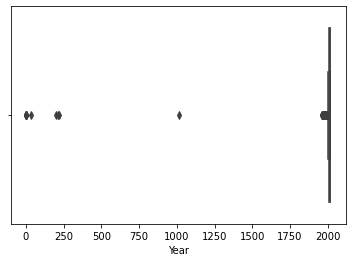

In [10]:
ax = sns.boxplot(x=hch['Year'])

In [11]:
hch['Comments'] = hch['Comments'].str.strip()

hch.loc[hch['Comments'].str.len()<2,'Comments'] = np.nan
hch.loc[hch['Comments']=="--",'Comments'] = np.nan
hch.loc[hch['Comments']=="****",'Comments'] = np.nan
hch.loc[hch['Comments']=="-*",'Comments'] = np.nan
hch.loc[hch['Comments']=="---",'Comments'] = np.nan
hch.loc[hch['Comments']=="**",'Comments'] = np.nan

hch['Causes'] = hch['Causes'].str.strip()
hch.loc[hch['Causes']=='HIPERGLICEMIA','Causes'] = 'HIPERGLUCEMIA'

hch.loc[hch['Year']<1900,'Year'] = np.nan

hch[pd.isna(hch['Causes'])]

,Comments,Causes,Days,Year,Patient ID,Hospitalization ID
81,PROBLEMAS EN VALVULA MITRAL,NaN,0,NaN,2092,83
1592,"PERDIDA DEL HABLA, INCREMENTO DE PRESION Y GLU...",NaN,5,NaN,45227,2440


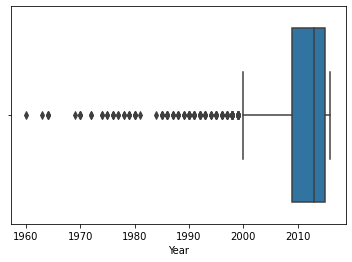

In [12]:
ax = sns.boxplot(x=hch['Year'])

  0%|                                                                                          | 0/752 [00:00<…

DataPrep Report
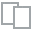
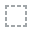
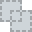
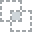
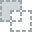
...
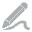
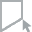
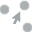
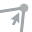
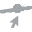

In [13]:
create_report(hch)

In [14]:
hch['Causes'].value_counts()[0:10]

HIPERGLUCEMIA          235
HIPERTENSION            49
HIPOGLUCEMIA            39
PANCREATITIS            37
COMA DIABETICO          26
CRISIS HIPERTENSIVA     19
NEUMONIA                16
HIPOTIROIDISMO          15
HISTERECTOMIA           14
EMBOLIA                 13
Name: Causes, dtype: int64

### historialcitascanceladas - capp: Cancelled appointments

In [15]:
capp.head(3)

,Cancelled Appointments ID,IdAgenda,Patient ID,Area,Create Date,Create Time,FechaAlta,Attendance,Reason,Branch id,Confirmacion,IdEstatusCita,Cancellation Date
0,1,94770,6979.0,NUTRICIÓN,2015-09-03,10:30:00,2014-10-27,NaN,NaN,3,NaN,AGENDADA,2015-09-02 15:01:46
1,2,166130,3385.0,CONTROL VITAL,2015-10-02,09:00:00,2015-09-02,NaN,NaN,3,NaN,AGENDADA,2015-09-02 15:06:21
2,3,166132,3385.0,NUTRICIÓN,2015-10-02,09:00:00,2015-09-02,NaN,NaN,3,NaN,AGENDADA,2015-09-02 15:06:37


In [16]:
capp.dtypes

Cancelled Appointments ID             int64
IdAgenda                              int64
Patient ID                          float64
Area                                 object
Create Date                  datetime64[ns]
Create Time                          object
FechaAlta                    datetime64[ns]
Attendance                           object
Reason                               object
Branch id                             int64
Confirmacion                         object
IdEstatusCita                        object
Cancellation Date            datetime64[ns]
dtype: object

In [17]:
capp = capp.astype({'Patient ID':'object', 'IdAgenda':'object', 'Cancelled Appointments ID':'object', 'Branch id':'object'})
capp.describe(include='all', datetime_is_numeric=True)

,Cancelled Appointments ID,IdAgenda,Patient ID,Area,Create Date,Create Time,FechaAlta,Attendance,Reason,Branch id,Confirmacion,IdEstatusCita,Cancellation Date
count,7162.0,7162.0,7147.0,7162,7162,7162,7162,407,6222,7162.0,1175,7162,7162
unique,7162.0,7021.0,3686.0,7,NaN,37,NaN,4,10,7.0,3,1,NaN
top,1.0,2383862.0,0.0,NUTRICIÓN,NaN,10:00:00,NaN,ASISTIO,CONSULTA NUTRICION,1.0,CONFIRMO,AGENDADA,NaN
freq,1.0,3.0,618.0,2264,NaN,879,NaN,356,1988,1853.0,796,7162,NaN
mean,NaN,NaN,NaN,NaN,2016-06-09 10:12:38.000558592,NaN,2016-03-01 19:25:21.027645696,NaN,NaN,NaN,NaN,NaN,2016-05-29 08:32:15.545378304
min,NaN,NaN,NaN,NaN,2015-09-03 00:00:00,NaN,2014-10-10 00:00:00,NaN,NaN,NaN,NaN,NaN,2015-09-02 15:01:46
25%,NaN,NaN,NaN,NaN,2016-02-27 00:00:00,NaN,2015-11-02 00:00:00,NaN,NaN,NaN,NaN,NaN,2016-02-17 21:42:16
50%,NaN,NaN,NaN,NaN,2016-06-24 00:00:00,NaN,2016-04-12 00:00:00,NaN,NaN,NaN,NaN,NaN,2016-06-09 10:21:01.500000
75%,NaN,NaN,NaN,NaN,2016-10-01 00:00:00,NaN,2016-06-02 00:00:00,NaN,NaN,NaN,NaN,NaN,2016-09-19 14:47:46.249999872
max,NaN,NaN,NaN,NaN,2016-12-31 00:00:00,NaN,2016-12-21 00:00:00,NaN,NaN,NaN,NaN,NaN,2016-12-30 15:01:00


<AxesSubplot:xlabel='Patient ID', ylabel='Count'>

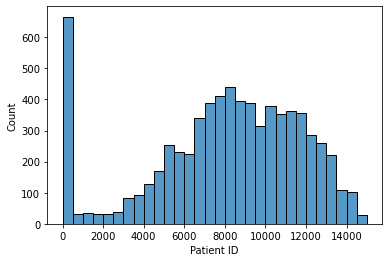

In [20]:
sns.histplot(data=capp, x='Patient ID')

In [21]:
capp['Patient ID'].value_counts()

0.0        618
2682.0      10
7331.0       9
3765.0       9
5007.0       9
          ... 
11509.0      1
3325.0       1
11521.0      1
11525.0      1
8191.0       1
Name: Patient ID, Length: 3686, dtype: int64

In [18]:
capp = capp.drop({'Attendance','Confirmacion','IdEstatusCita'},1) #94.3% missing in Attendance and 83.6% missing in Confirmacion

  0%|                                                                                          | 0/773 [00:00<…

DataPrep Report
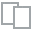
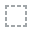
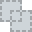
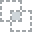
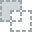
...
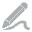
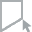
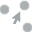
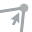
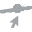

In [19]:
create_report(capp)

### historialcitasagendadas - sapp: Scheduled appointments

In [22]:
sapp.dtypes

Create Time              object
Create Date      datetime64[ns]
FechaAlta        datetime64[ns]
Attendance               object
Reason                   object
Branch id                 int64
IdEstatusCita            object
Change Date      datetime64[ns]
FechaAgenda             float64
dtype: object

In [23]:
sapp = sapp.astype({'Branch id':'object'})
sapp.describe(include='all', datetime_is_numeric=True)

,Create Time,Create Date,FechaAlta,Attendance,Reason,Branch id,IdEstatusCita,Change Date,FechaAgenda
count,10883,10883,10883,145,10071,10883.0,10883,10883,0.0
unique,37,NaN,NaN,4,10,7.0,2,NaN,NaN
top,10:00:00,NaN,NaN,ASISTIO,CONSULTA NUTRICION,1.0,AGENDADA,NaN,NaN
freq,1271,NaN,NaN,91,2609,3728.0,10882,NaN,NaN
mean,NaN,2016-07-02 04:54:32.185978112,2016-03-21 20:06:43.565193216,NaN,NaN,NaN,NaN,2016-06-25 09:14:55.720756992,NaN
min,NaN,2015-09-03 00:00:00,2014-10-10 00:00:00,NaN,NaN,NaN,NaN,2015-09-02 20:11:54,NaN
25%,NaN,2016-03-31 00:00:00,2015-12-14 00:00:00,NaN,NaN,NaN,NaN,2016-03-21 16:32:37.500000,NaN
50%,NaN,2016-07-21 00:00:00,2016-04-25 00:00:00,NaN,NaN,NaN,NaN,2016-07-13 17:43:19,NaN
75%,NaN,2016-10-20 00:00:00,2016-06-07 00:00:00,NaN,NaN,NaN,NaN,2016-10-11 12:29:04,NaN
max,NaN,2016-12-31 00:00:00,2016-12-14 00:00:00,NaN,NaN,NaN,NaN,2016-12-30 17:29:07,NaN


In [30]:
sapp.drop({'FechaAgenda','Attendance','IdEstatusCita'})

  0%|                                                                                          | 0/429 [00:00<…

DataPrep Report
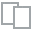
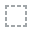
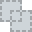
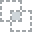
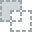
...
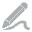
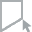
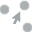
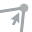
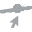

In [31]:
create_report(sapp)

### pacientes - patient: Patient profile

In [32]:
patient.head(3)

,Patient ID,YearBirth,Branch id,Town,State,Sex,Marital status,Religion,Ocupacion,Scholarship,Create Date,Create Time,IdInteresado,ProgramaRecomendados,Social Security,RecordarCita,EstadioValor,Estadio
0,1,1928.0,1,GUADALUPE,NUEVO LEÓN,H,SOLTERÍA,CATOLICA,ALBAÑIL,NINGUNA,2013-02-19,13:55:23,16432,0,imss,1,NaN,NaN
1,2,1971.0,1,GUADALUPE,NUEVO LEÓN,H,MATRIMONIO,NaN,INSTALACION MECANICA,LEER Y ESCRIBIR,2013-02-19,13:55:23,16433,0,IMSS,1,NaN,NaN
2,3,1943.0,1,GUADALUPE,NUEVO LEÓN,M,MATRIMONIO,CATOLICA,HOGAR,PREPARATORIA,2013-02-19,13:55:23,16434,0,IMSS,1,8.8,5.0


In [33]:
patient.dtypes

Patient ID                       int64
YearBirth                      float64
Branch id                        int64
Town                            object
State                           object
Sex                             object
Marital status                  object
Religion                        object
Ocupacion                       object
Scholarship                     object
Create Date             datetime64[ns]
Create Time                     object
IdInteresado                     int64
ProgramaRecomendados             int64
Social Security                 object
RecordarCita                     int64
EstadioValor                   float64
Estadio                        float64
dtype: object

In [34]:
patient = patient.astype({'Patient ID':'object', 'Branch id':'object', 'ProgramaRecomendados':'object', 'IdInteresado':'object'})
patient.describe(include='all')

<ipython-input-34-80d7bea91bb2>:2: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  patient.describe(include='all')


,Patient ID,YearBirth,Branch id,Town,State,Sex,Marital status,Religion,Ocupacion,Scholarship,Create Date,Create Time,IdInteresado,ProgramaRecomendados,Social Security,RecordarCita,EstadioValor,Estadio
count,14855.0,14813.000000,14855.0,14807,14812,14714,14648,5186,14236,5076,14855,14855,14855.0,14855.0,14488,14855.000000,3701.000000,3701.000000
unique,14855.0,NaN,7.0,227,19,2,5,138,234,8,1124,11631,14855.0,2.0,72,NaN,NaN,NaN
top,1.0,NaN,1.0,MONTERREY,NUEVO LEÓN,M,MATRIMONIO,CATOLICA,EMPLEADO,PREPARATORIA,2013-02-19 00:00:00,13:55:23,32768.0,0.0,IMSS,NaN,NaN,NaN
freq,1.0,NaN,6215.0,3148,14713,8278,10492,2809,5196,1313,817,770,1.0,13039.0,8954,NaN,NaN,NaN
first,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2013-02-19 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016-12-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,1962.313576,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.998452,97.153148,1.366928
std,NaN,12.855983,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.039319,27.069176,0.833052
min,NaN,1900.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000
25%,NaN,1954.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,89.300000,1.000000


  0%|                                                                                          | 0/429 [00:00<…

DataPrep Report
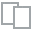
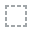
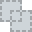
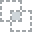
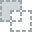
...
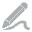
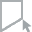
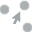
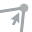
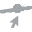

In [37]:
create_report(sapp)